<div style="background-image: url('style_notebook.jpeg'); padding: 20px;
            border-radius: 10px; background-attachment: fixed;">
    <div style="margin: 20px; margin-top: 100px; color: white;">
        <center>
            <b style="font-size: 40px;">Network Analysis: Final Project</b><br />
            <br />
            <b style="font-size: 30px;">Exploratory Analysis
            <br>
        </center>
        <div style="font-size: 20px; margin-left: 60%; margin-top: 50px;">
            <b>Trabalho reallizado por:</b>
            <ul>
                <li>Rodrigo Sarroeira, nº 92761</li>
                <li>Wendel Vilaça, nº 109881</li>
            </ul>
        </div>
    </div>
</div>

<div style="background-image: url('style_notebook.jpeg'); padding: 10px;
            border-radius: 20px; color: white; background-attachment: fixed;">
    <center><h1>0. Imports</h1></center>
</div>

In [2]:
import json
import folium
import geopandas
import geopy as gp
import numpy as np
import pandas as pd
import networkx as nx
from folium import plugins
import shapely.geometry as geo
import matplotlib.pyplot as plt
from folium.plugins import HeatMap
from geopy.geocoders import Nominatim

<div style="background-image: url('style_notebook.jpeg'); padding: 10px;
            border-radius: 20px; color: white; background-attachment: fixed">
    <center><h1>1. Read Data</h1></center>
</div>

In [3]:
data = pd.read_csv("data/csv/data_analysis.csv")

In [4]:
data.head()

,index,id,vendor_id,time1,time2,n_pass,y1,x1,y2,x2,...,trip_duration,dist,area1,area2,year,month,hour,trip_pickup_date,trip_pickup_time,trip_dur_min
0,1389059,id0984631,2,2016-01-01 20:32:40,2016-01-01 20:39:25,1,-73.987457,40.728981,-73.988541,40.719597,...,405,0.009446,79,64,2016,1,20,2016-01-01,20:32:40,6
1,846163,id2158882,2,2016-03-06 03:42:56,2016-03-06 03:55:33,1,-73.991661,40.726768,-73.991966,40.722000,...,757,0.004778,64,64,2016,3,3,2016-03-06,03:42:56,12
2,1098897,id3078927,1,2016-03-18 22:24:47,2016-03-18 22:42:27,2,-73.991417,40.742203,-73.983604,40.764332,...,1060,0.023468,94,125,2016,3,22,2016-03-18,22:24:47,17
3,1349608,id3580013,2,2016-03-23 22:49:54,2016-03-23 22:54:58,1,-73.999756,40.714008,-74.006424,40.708183,...,304,0.008854,48,32,2016,3,22,2016-03-23,22:49:54,5
4,831079,id0568067,2,2016-01-18 18:13:12,2016-01-18 18:26:31,2,-73.973000,40.785309,-73.993279,40.752232,...,799,0.038799,156,109,2016,1,18,2016-01-18,18:13:12,13


<div style="background-image: url('style_notebook.jpeg'); padding: 10px;
            border-radius: 20px; color: white; background-attachment: fixed">
    <center><h1>2. Exploratory Analysis</h1></center>
</div>

 <div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.1 Trip Duration</h1></center>
</div>

TypeError: no numeric data to plot

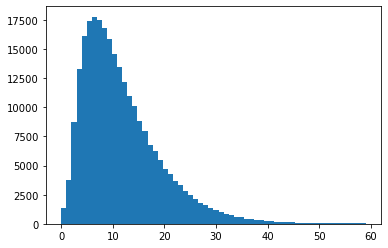

In [5]:
# Poisson distribution
plt.hist(data["trip_dur_min"], bins=60)
data.plot.line(x='trip_dur_min', y='id', color="red")
plt.title("Trip duration in Minutes", size=15)
plt.ylabel("Count")
plt.xlabel("Minutes")
plt.show()

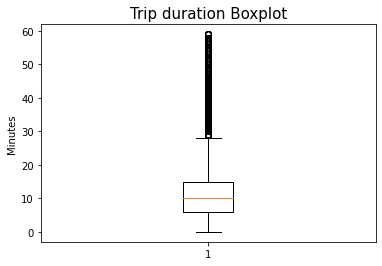

In [6]:
plt.boxplot(data["trip_dur_min"])
plt.title("Trip duration Boxplot", size=15)
plt.ylabel("Minutes")
plt.show()

In [7]:
data.trip_dur_min.quantile(np.array(range(1, 11)) * 0.1)

0.1     3.0
0.2     5.0
0.3     6.0
0.4     8.0
0.5    10.0
0.6    12.0
0.7    14.0
0.8    17.0
0.9    22.0
1.0    59.0
Name: trip_dur_min, dtype: float64

 <div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.2 Trips by date</h1></center>
</div>

In [8]:
# 2016-01-23 ---> 302 lowest

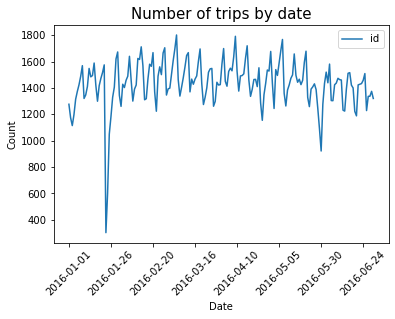

In [9]:
trips_anual = data.groupby(['trip_pickup_date'])['id'].count().reset_index()
trips_anual.plot.line(x='trip_pickup_date', y='id')
plt.title("Number of trips by date", size=15)
plt.xlabel("Date")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

 <div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.3 Trips by hour</h1></center>
</div>

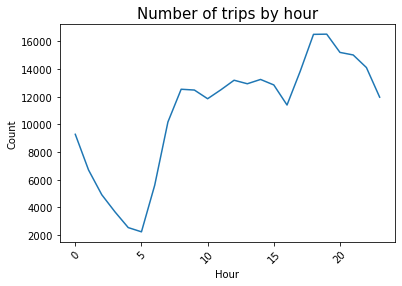

In [10]:
trip_pickup_time = data.groupby(['hour'])['id'].count()
trip_pickup_time.plot.line(x='trip_pickup_time',y='id')
plt.title("Number of trips by hour", size=15)
plt.xlabel("Hour")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

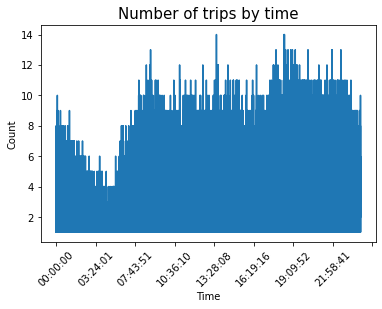

In [11]:
trip_pickup_time = data.groupby(['trip_pickup_time'])['id'].count()
trip_pickup_time.plot.line(x='trip_pickup_time',y='id')
plt.title("Number of trips by time", size=15)
plt.xticks(rotation=45)
plt.xlabel("Time")
plt.ylabel("Count")
plt.show()

 <div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.4 Number of passengers per trip</h1></center>
</div>

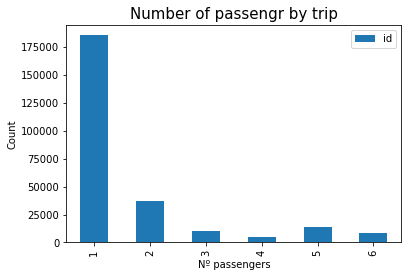

In [12]:
hist = data.groupby(["n_pass"])["id"].count()[1:].reset_index()
hist.plot(kind='bar', x='n_pass', y='id')
plt.title("Number of passengr by trip", size=15)
plt.xlabel("Nº passengers")
plt.ylabel("Count")
plt.show()

<div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.5 Pickup hotspots originated by Geopy</h1></center>
</div>

In [19]:
geolocator = Nominatim(user_agent="geoapiExercises")

In [32]:
# Create a column for the start coordinates
data['start'] = ('"'+round(data['x1'], 3).map(str) + ',' + round(data['y1'], 3).map(str)+'"')

start = data.groupby(['start'])['id'].count().reset_index()
start_sort = start.sort_values('id', ascending=False)
start_top_5 = start_sort.head(5)
start_top_5

,start,id
2797,"""40.751,-73.994""",1696
2735,"""40.75,-73.991""",1513
2736,"""40.75,-73.992""",1189
3183,"""40.757,-73.99""",840
3120,"""40.756,-73.991""",790


In [33]:
addresses = start_top_5.apply(lambda row: geolocator.reverse(
    (float(row['start'].split(",")[0][1:]),
     float(row['start'].split(",")[1][:-1]))), axis=1)

new_addresses = []
for adress in addresses:
    new_addresses.append(adress[0].split(",")[0])

start_top_5["address"] = new_addresses
start_top_5

<ipython-input-33-b7736fcb0179>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  start_top_5["address"] = new_addresses


,start,id,address
2797,"""40.751,-73.994""",1696,Madison Square Garden
2735,"""40.75,-73.991""",1513,Pennsylvania Station
2736,"""40.75,-73.992""",1189,The Pennsy Food Hall
3183,"""40.757,-73.99""",840,42nd Street–Times Square–Port Authority Bus Te...
3120,"""40.756,-73.991""",790,42nd Street–Times Square–Port Authority Bus Te...


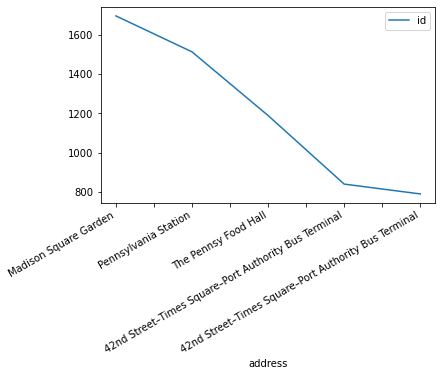

In [34]:
start_top_5.plot.line(x='address', y='id')
plt.gcf().autofmt_xdate()

<div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.6 Dropout hotspots originated by Geopy</h1></center>
</div>

In [29]:
# Create a column for the start coordinates
data['end'] = ('"'+round(data['x2'], 3).map(str) + ',' + round(data['y2'], 3).map(str)+'"')

end = data.groupby(['end'])['id'].count().reset_index()
end_sort = end.sort_values('id', ascending=False)
end_top_5 = end_sort.head(5)
end_top_5

,end,id
4398,"""40.75,-73.991""",1369
4324,"""40.749,-73.992""",1101
4402,"""40.75,-73.995""",982
4465,"""40.751,-73.991""",757
4399,"""40.75,-73.992""",607


In [30]:
addresses = end_top_5.apply(lambda row: geolocator.reverse(
    (float(row['end'].split(",")[0][1:]),
     float(row['end'].split(",")[1][:-1]))), axis=1)

new_addresses = []
for adress in addresses:
    new_addresses.append(adress[0].split(",")[0])

end_top_5["address"] = new_addresses
end_top_5

<ipython-input-30-a890f0acefa6>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  end_top_5["address"] = new_addresses


,end,id,address
4398,"""40.75,-73.991""",1369,Pennsylvania Station
4324,"""40.749,-73.992""",1101,Stewart Hotel
4402,"""40.75,-73.995""",982,LinkNYC
4465,"""40.751,-73.991""",757,Pennsylvania Station
4399,"""40.75,-73.992""",607,The Pennsy Food Hall


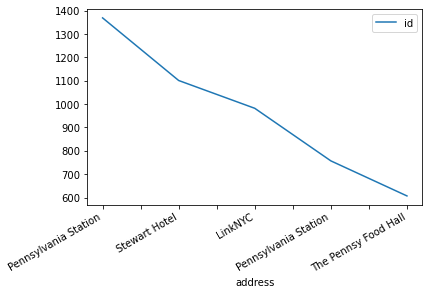

In [31]:
end_top_5.plot.line(x='address', y='id')
plt.gcf().autofmt_xdate()

<div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.7 Pickup locations heatmap</h1></center>
</div>

In [41]:
pickup_heat = folium.Map(location=[40.770610, -73.950242], zoom_start=11) 

# Ensure you're handing it floats
data['x1'] = data['x1'].astype(float)
data['y1'] = data['y1'].astype(float)

# Filter the DF for rows, then columns, then remove NaNs
heat_df = data[['x1', 'y1']]
heat_df = heat_df.dropna(axis=0, subset=['x1','y1'])

# List comprehension to make out list of lists
heat_data = [[row['x1'],row['y1']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data, min_opacity=0.5, max_opacity=1, max_zoom=1, radius=15).add_to(pickup_heat)

pickup_heat

<div style="border: 4px solid black;
            border-radius: 20px; color: white; background-attachment: fixed; color: black; padding: 5px;">
    <center><h1>2.8 Drop-off locations heatmap</h1></center>
</div>

In [40]:
dropoff_heat = folium.Map(location=[40.770610, -73.950242], zoom_start=11) 

# Ensure you're handing it floats
data['x2'] = data['x2'].astype(float)
data['y2'] = data['y2'].astype(float)

# Filter the DF for rows, then columns, then remove NaNs
heat_df = data[['x2', 'y2']]
heat_df = heat_df.dropna(axis=0, subset=['x2','y2'])

# List comprehension to make out list of lists
heat_data = [[row['x2'],row['y2']] for index, row in heat_df.iterrows()]

# Plot it on the map
HeatMap(heat_data, min_opacity=0.5, max_opacity=1, max_zoom=1, radius=15).add_to(dropoff_heat)

dropoff_heat